In [2]:
!pip install supervision==0.8.0 ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.1/42.1 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 45.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 127.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 98.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 104.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12


In [3]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import yaml
import cv2
import supervision as sv
from ultralytics import YOLO
import copy
from pathlib import Path
import torch
import torch.nn as nn
from torchvision.models.feature_extraction import create_feature_extractor
from collections import OrderedDict
from torchvision.ops.feature_pyramid_network import FeaturePyramidNetwork
from torchvision.models.detection.anchor_utils import AnchorGenerator
import torchvision
import torch.optim as optim
from tqdm import tqdm
from torchvision.ops import nms
import torchvision.transforms as T
from torchvision.ops.boxes import box_iou
from torch.utils.data import DataLoader
import xml.etree.ElementTree as ET
import torchvision
import cv2
import random
from PIL import Image
from collections import Counter
import torchvision.transforms.functional as F
from collections import Counter
from IPython.display import Video

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


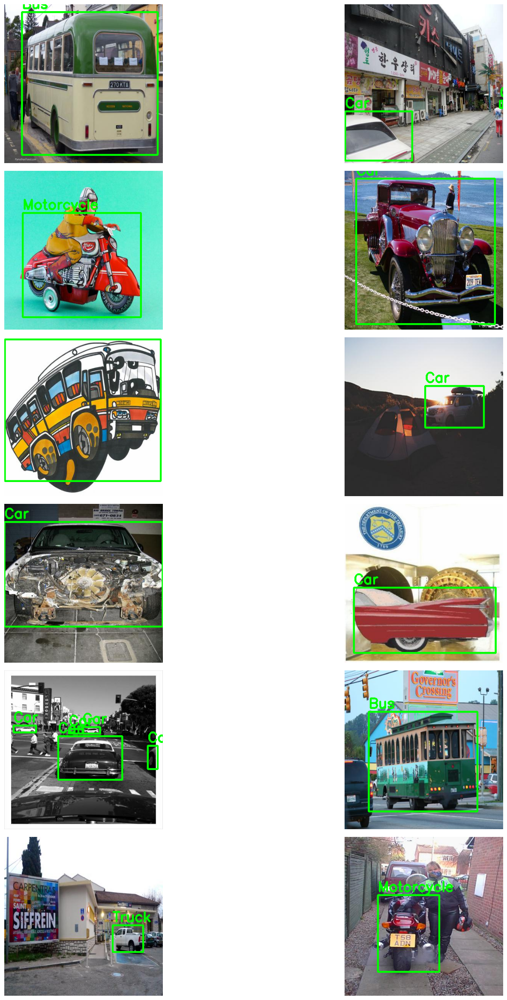

In [4]:
# Define dataset paths
base_path = Path('/content/drive/MyDrive/CSE475/VehiclesDetectionDataset')
train_images = base_path / 'train/images'
train_labels = base_path / 'train/labels'
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']

# Function to convert image filenames to label filenames
def JPG_Name_To_TXT(image_name):
    """Convert image filename to corresponding YOLO label filename."""
    return image_name.rsplit('.', 1)[0] + ".txt"

# Function to get image dimensions
def get_image_dimensions(img_path):
    """Returns height and width of an image."""
    img = cv2.imread(str(img_path))
    return img.shape[:2]  # (height, width)

# Function to convert YOLO TXT annotation to bounding box coordinates
def TXT_To_BBOX(txt_path, img_height, img_width):
    """Reads YOLO format TXT and converts it to (x_min, y_min, x_max, y_max, class_id)."""
    bboxes = []
    with open(txt_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            class_id = int(parts[0])
            x_center, y_center, width, height = map(float, parts[1:])

            # Convert YOLO format to pixel coordinates
            x_min = int((x_center - width / 2) * img_width)
            y_min = int((y_center - height / 2) * img_height)
            x_max = int((x_center + width / 2) * img_width)
            y_max = int((y_center + height / 2) * img_height)

            bboxes.append((x_min, y_min, x_max, y_max, class_id))
    return bboxes

# Function to plot images with bounding boxes
def Plot_Random_Images():
    """Randomly selects images and plots them with their bounding boxes."""
    random_images = random.choices(list(train_images.iterdir()), k=12)

    plt.figure(figsize=(20, 30))  # Large figure size to make images bigger
    for i, img_path in enumerate(random_images, 1):
        plt.subplot(6, 2, i)  # 6 rows, 2 columns

        # Read the image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Get the label path
        txt_name = JPG_Name_To_TXT(img_path.name)
        lbl_path = train_labels / txt_name

        if lbl_path.exists():  # Check if the label file exists
            img_height, img_width = get_image_dimensions(img_path)

            # Get bounding boxes
            bboxes = TXT_To_BBOX(lbl_path, img_height, img_width)

            # Draw bounding boxes
            for (x_min, y_min, x_max, y_max, class_id) in bboxes:
                color = (0, 255, 0)  # Green for bounding boxes
                cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color, 3)
                cv2.putText(
                    img,
                    f"{class_names[class_id]}",
                    (x_min, y_min - 10),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    1.2,
                    color,
                    3
                )

        plt.imshow(img)
        plt.axis('off')  # Hide axis for cleaner layout

    plt.subplots_adjust(wspace=0.05, hspace=0.05)  # Reduce space between images
    plt.show()

# Run the function
Plot_Random_Images()


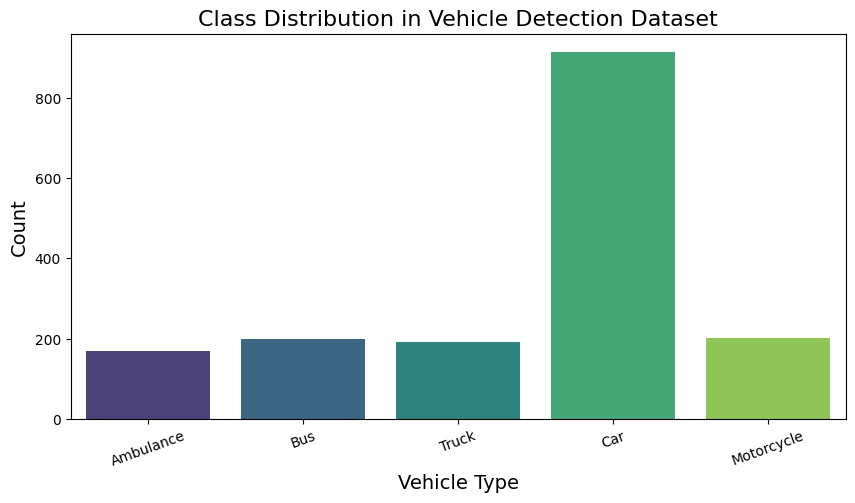

In [5]:
def Count_Classes():
    """
    Reads all label files and counts the occurrences of each class.
    """
    class_counts = Counter()

    # Loop through all label files
    for lbl_path in train_labels.iterdir():
        with open(lbl_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])  # Extract class ID
                class_counts[class_names[class_id]] += 1  # Increment count

    # Plot countplot
    plt.figure(figsize=(10, 5))
    sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette="viridis")
    plt.xlabel("Vehicle Type", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.title("Class Distribution in Vehicle Detection Dataset", fontsize=16)
    plt.xticks(rotation=20)  # Rotate labels for better readability
    plt.show()

Count_Classes()


100%|██████████| 18.4M/18.4M [00:00<00:00, 305MB/s]



image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/images/09fd3f0199f2be7e_jpg.rf.1NoHW56IuJhRAiX5KW2H.jpg: 416x416 1 person, 1 bicycle, 1 motorcycle, 26.1ms
Speed: 2.3ms preprocess, 26.1ms inference, 495.8ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/images/a7a0f7d1903a8072_jpg.rf.a0236239a7198d8b959b7b2ab5ef4ad8.jpg: 416x416 1 person, 1 truck, 16.3ms
Speed: 1.2ms preprocess, 16.3ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/images/089cc41a901b2653_jpg.rf.d86qKnK017K3pSWOEpdb.jpg: 416x416 3 cars, 3 trucks, 14.7ms
Speed: 1.2ms preprocess, 14.7ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/images/3b53976a94e33073_jpg.rf.4909479cba7818468fd1cbc1c8868d2a.jpg: 416x416 3 persons, 1 bicycle, 2 cars, 1 truck, 11.

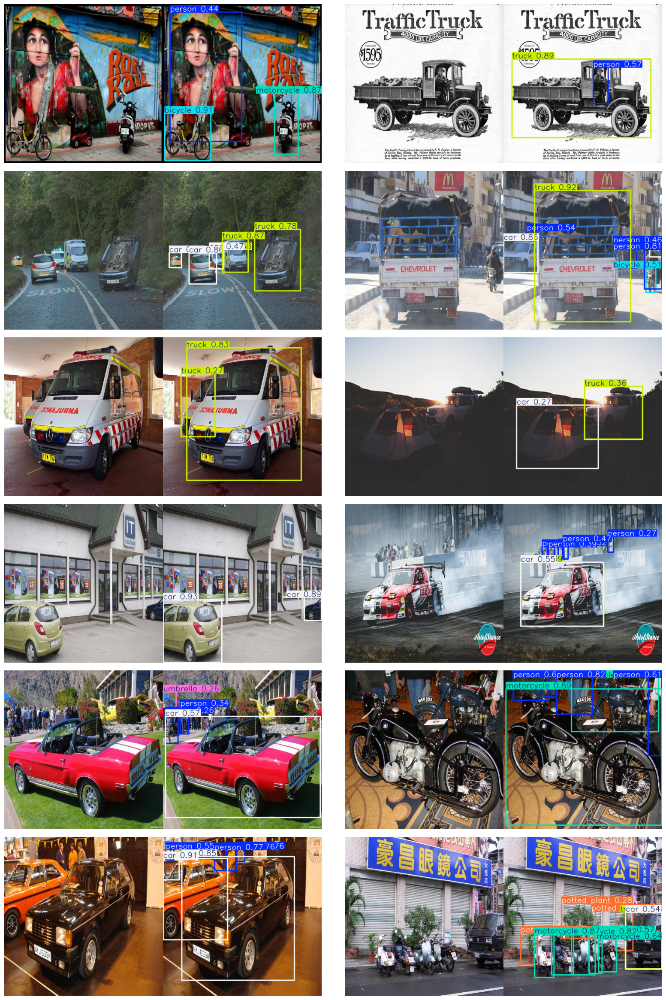

In [6]:
# Define image folder path
images_folder = '/content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/images'

# Get image file list
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Select 12 random images (since 6 columns × 2 images per column = 12 images)
random_images = random.sample(image_files, 12)

# Load YOLOv11 model
model = YOLO("yolo11s.pt")

# Set up plot layout (6 columns, 2 rows → each pair appears horizontally)
fig, axes = plt.subplots(6, 2, figsize=(20, 30))  # Large images, well-spaced
axes = axes.flatten()  # Flatten for easy indexing

# Process and plot images
for i, image_file in enumerate(random_images):
    image_path = os.path.join(images_folder, image_file)

    # Run YOLO prediction
    result_predict = model.predict(source=image_path, imgsz=(416))

    # Load original image
    original_image = Image.open(image_path)
    original_array = np.array(original_image)  # Convert to NumPy array

    # Get YOLO-predicted image
    for result in result_predict:
        plot = result.plot()
        plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)  # Convert to RGB format

    # Combine images horizontally
    combined_image = np.hstack((original_array, plot))

    # Display the combined image
    axes[i].imshow(combined_image)
    axes[i].axis('off')

# Adjust spacing to make images tight
plt.subplots_adjust(wspace=0.05, hspace=0.05)
plt.show()


In [7]:
# Define the dataset_path
dataset_path = '/content/drive/MyDrive/CSE475/VehiclesDetectionDataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'dataset.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))


names:
- Ambulance
- Bus
- Car
- Motorcycle
- Truck
nc: 5
test: ../test/images
train: ../train/images
val: ../valid/images



In [8]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 878
Number of validation images: 250
All training images have the same size: (416, 416)
All validation images have the same size: (416, 416)


In [9]:
model = YOLO("yolo11n.pt")

100%|██████████| 5.35M/5.35M [00:00<00:00, 375MB/s]


In [10]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=150,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=10,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    #freeze=20,               # first lets build from scrach
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/CSE475/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0.

100%|██████████| 755k/755k [00:00<00:00, 101MB/s]

Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

YOLO11n summary: 181 layers, 2,590,815 parameters, 2,590,799 gradients, 6.4 GFLOPs

Transferred 448/499 items from pretrained weights
Freezing layer 'model.23.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...
AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.5±0.1 ms, read: 17.0±7.9 MB/s, size: 29.7 KB)


train: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/labels.cache... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 1.3±0.5 ms, read: 19.4±4.1 MB/s, size: 33.0 KB)


val: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      1.84G      1.101      3.229      1.293         56        416: 100%|██████████| 28/28 [00:12<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.39it/s]

                   all        250        454    0.00544      0.869       0.26      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150       2.2G      1.194      2.492      1.369         53        416: 100%|██████████| 28/28 [00:10<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.09it/s]

                   all        250        454      0.539     0.0302      0.187      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      2.21G      1.217      2.138      1.382         46        416: 100%|██████████| 28/28 [00:09<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]

                   all        250        454       0.39      0.237      0.211      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      2.22G      1.216      1.998      1.352         40        416: 100%|██████████| 28/28 [00:09<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]

                   all        250        454      0.217      0.235      0.133     0.0522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150      2.23G      1.254       1.95       1.39         48        416: 100%|██████████| 28/28 [00:07<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.63it/s]

                   all        250        454      0.212      0.325      0.193       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      2.24G       1.28      1.952        1.4         49        416: 100%|██████████| 28/28 [00:09<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.03it/s]

                   all        250        454      0.265      0.366      0.235      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      2.24G      1.222      1.788      1.355         49        416: 100%|██████████| 28/28 [00:09<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.95it/s]

                   all        250        454      0.558      0.229      0.208      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      2.24G      1.203       1.74       1.34         58        416: 100%|██████████| 28/28 [00:09<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]

                   all        250        454      0.524       0.26      0.266      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150      2.24G      1.221      1.696      1.344         69        416: 100%|██████████| 28/28 [00:09<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.08it/s]

                   all        250        454      0.428      0.391      0.379      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      2.24G      1.169      1.628      1.315         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.42it/s]

                   all        250        454      0.834      0.286      0.391      0.281



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      2.24G      1.112      1.563      1.285         47        416: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.49it/s]

                   all        250        454      0.552       0.43      0.447      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      2.24G      1.154      1.541      1.306         49        416: 100%|██████████| 28/28 [00:10<00:00,  2.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.33s/it]

                   all        250        454      0.478      0.406       0.41      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      2.24G      1.099      1.478      1.278         56        416: 100%|██████████| 28/28 [00:08<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.39it/s]

                   all        250        454      0.519      0.402      0.422      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      2.25G       1.09      1.441      1.264         64        416: 100%|██████████| 28/28 [00:08<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]

                   all        250        454      0.403      0.417      0.408      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      2.26G      1.106      1.412      1.265         50        416: 100%|██████████| 28/28 [00:09<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.10it/s]

                   all        250        454      0.632       0.39      0.451      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      2.27G      1.087      1.412      1.262         55        416: 100%|██████████| 28/28 [00:11<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454       0.48      0.423      0.393      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      2.27G      1.054      1.357      1.259         58        416: 100%|██████████| 28/28 [00:09<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454        0.6      0.413       0.48       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      2.27G      1.051      1.325      1.249         66        416: 100%|██████████| 28/28 [00:08<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.50it/s]

                   all        250        454      0.659      0.478      0.505      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      2.27G      1.021      1.282      1.218         46        416: 100%|██████████| 28/28 [00:08<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.59it/s]

                   all        250        454       0.44      0.397      0.413      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      2.27G      1.059      1.317      1.247         42        416: 100%|██████████| 28/28 [00:08<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.02it/s]

                   all        250        454      0.664      0.449      0.496       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      2.27G     0.9848      1.221      1.208         57        416: 100%|██████████| 28/28 [00:10<00:00,  2.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454      0.581      0.429      0.476      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      2.27G      1.033      1.242      1.221         54        416: 100%|██████████| 28/28 [00:09<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.91it/s]

                   all        250        454      0.523      0.459      0.465      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      2.27G       1.02      1.227      1.214         56        416: 100%|██████████| 28/28 [00:09<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.18it/s]

                   all        250        454      0.772      0.402      0.515      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      2.27G      1.016      1.183      1.209         53        416: 100%|██████████| 28/28 [00:09<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.89it/s]

                   all        250        454      0.499      0.457      0.456      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      2.27G     0.9815      1.146      1.197         62        416: 100%|██████████| 28/28 [00:07<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.29it/s]

                   all        250        454      0.481      0.404      0.452      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      2.27G     0.9724      1.131      1.193         65        416: 100%|██████████| 28/28 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.03it/s]

                   all        250        454      0.599      0.488        0.5      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      2.27G     0.9836      1.109      1.188         63        416: 100%|██████████| 28/28 [00:09<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]

                   all        250        454      0.565       0.42      0.432      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      2.27G     0.9684      1.081      1.183         45        416: 100%|██████████| 28/28 [00:09<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        250        454      0.541      0.499      0.485       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150      2.27G     0.9674      1.068      1.179         51        416: 100%|██████████| 28/28 [00:09<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]

                   all        250        454      0.514      0.544      0.521      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      2.27G     0.9356      1.054      1.166         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.54it/s]

                   all        250        454      0.565      0.342      0.358      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      2.27G     0.9343      1.063      1.174         39        416: 100%|██████████| 28/28 [00:08<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.62it/s]

                   all        250        454      0.638      0.413      0.482       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      2.27G     0.9325      1.023       1.16         40        416: 100%|██████████| 28/28 [00:08<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.98it/s]

                   all        250        454      0.597      0.446      0.483      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      2.27G     0.9334      1.017      1.159         35        416: 100%|██████████| 28/28 [00:09<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]

                   all        250        454      0.618      0.449      0.503      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      2.27G     0.9306      1.013      1.161         39        416: 100%|██████████| 28/28 [00:09<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]

                   all        250        454      0.547      0.486      0.505       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      2.27G     0.9195      1.013      1.154         32        416: 100%|██████████| 28/28 [00:09<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454      0.593      0.478        0.5      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150      2.27G     0.8992     0.9561      1.149         50        416: 100%|██████████| 28/28 [00:08<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.41it/s]

                   all        250        454      0.783      0.407      0.494      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      2.27G     0.9099     0.9934      1.155         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.57it/s]

                   all        250        454      0.777        0.4      0.527      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      2.27G     0.9033     0.9566      1.142         53        416: 100%|██████████| 28/28 [00:08<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.04it/s]

                   all        250        454      0.611      0.513      0.526      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      2.27G     0.9108     0.9447      1.138         66        416: 100%|██████████| 28/28 [00:09<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]

                   all        250        454       0.46      0.433      0.437      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      2.27G     0.9023      0.925      1.134         58        416: 100%|██████████| 28/28 [00:11<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.13it/s]

                   all        250        454        0.6      0.497      0.538        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      2.27G     0.8737     0.9042      1.121         71        416: 100%|██████████| 28/28 [00:09<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.81it/s]

                   all        250        454      0.642      0.437      0.493      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      2.27G     0.8934     0.9341      1.141         43        416: 100%|██████████| 28/28 [00:09<00:00,  2.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]

                   all        250        454      0.582      0.514      0.543      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      2.27G     0.8828     0.9312      1.141         61        416: 100%|██████████| 28/28 [00:08<00:00,  3.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.28it/s]

                   all        250        454      0.626      0.517      0.511      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      2.27G     0.8581     0.8821      1.114         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.70it/s]

                   all        250        454      0.612      0.481      0.519      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      2.27G     0.8678     0.8716      1.115         39        416: 100%|██████████| 28/28 [00:08<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.97it/s]

                   all        250        454      0.579      0.526      0.546      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      2.27G     0.8283     0.8518      1.114         53        416: 100%|██████████| 28/28 [00:09<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454      0.534      0.505      0.487      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      2.27G     0.8414     0.8452       1.11         48        416: 100%|██████████| 28/28 [00:09<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]

                   all        250        454      0.609      0.456      0.519      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      2.27G     0.8563     0.8467      1.112         58        416: 100%|██████████| 28/28 [00:09<00:00,  2.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.05it/s]

                   all        250        454      0.583      0.508      0.546      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      2.27G     0.8315     0.8553      1.105         57        416: 100%|██████████| 28/28 [00:08<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.20it/s]

                   all        250        454      0.577      0.527      0.507      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      2.27G     0.8522     0.8709      1.113         52        416: 100%|██████████| 28/28 [00:08<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.86it/s]

                   all        250        454      0.652      0.461       0.52      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      2.27G     0.8411     0.8353      1.108         54        416: 100%|██████████| 28/28 [00:09<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]

                   all        250        454      0.578       0.49      0.526      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      2.27G     0.8461      0.853      1.112         61        416: 100%|██████████| 28/28 [00:09<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]

                   all        250        454       0.68      0.484       0.55      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      2.27G     0.8412       0.83      1.096         48        416: 100%|██████████| 28/28 [00:09<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]

                   all        250        454      0.584      0.361      0.423      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      2.27G     0.8267     0.7999      1.097         50        416: 100%|██████████| 28/28 [00:09<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.07it/s]

                   all        250        454      0.611      0.489      0.553      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      2.27G     0.8081     0.7793      1.081         45        416: 100%|██████████| 28/28 [00:08<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.44it/s]

                   all        250        454      0.607       0.47      0.505      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150      2.27G     0.8217     0.7895      1.087         53        416: 100%|██████████| 28/28 [00:07<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.83it/s]

                   all        250        454       0.61      0.561      0.556      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      2.27G     0.8001     0.7746       1.08         55        416: 100%|██████████| 28/28 [00:08<00:00,  3.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.03it/s]

                   all        250        454      0.672      0.545      0.568      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      2.27G     0.8037     0.7717      1.088         45        416: 100%|██████████| 28/28 [00:09<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]

                   all        250        454      0.734      0.494      0.589      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      2.27G     0.8057     0.7757      1.078         44        416: 100%|██████████| 28/28 [00:09<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.23it/s]

                   all        250        454      0.653      0.461      0.485      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      2.27G     0.8062     0.7679      1.091         53        416: 100%|██████████| 28/28 [00:09<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.84it/s]

                   all        250        454      0.574      0.507      0.529      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      2.27G     0.7891     0.7603      1.087         56        416: 100%|██████████| 28/28 [00:08<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.42it/s]

                   all        250        454       0.57       0.52      0.527      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      2.27G     0.7812     0.7451      1.076         45        416: 100%|██████████| 28/28 [00:07<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.78it/s]

                   all        250        454      0.693      0.484      0.524      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      2.27G     0.7822     0.7497       1.08         50        416: 100%|██████████| 28/28 [00:09<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]

                   all        250        454      0.546      0.543      0.512       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      2.27G     0.7539     0.7193       1.06         45        416: 100%|██████████| 28/28 [00:09<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]

                   all        250        454      0.712      0.459      0.536      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      2.27G     0.7632     0.7103      1.065         60        416: 100%|██████████| 28/28 [00:11<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.13it/s]

                   all        250        454      0.625      0.567      0.571      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      2.27G     0.7636      0.717      1.071         41        416: 100%|██████████| 28/28 [00:09<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:02<00:00,  1.94it/s]

                   all        250        454      0.652      0.493      0.542      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      2.27G     0.7771     0.7264      1.069         61        416: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:03<00:00,  1.32it/s]

                   all        250        454      0.536      0.552      0.544      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      2.27G     0.7557     0.7025      1.062         44        416: 100%|██████████| 28/28 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]

                   all        250        454      0.555      0.575      0.555      0.409
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 58, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



68 epochs completed in 0.224 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.4MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.4MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.03s/it]


                   all        250        454      0.735      0.494       0.59      0.444
             Ambulance         50         64      0.953      0.637      0.869      0.724
                   Bus         30         46      0.793      0.667      0.683      0.596
                   Car         90        238      0.834      0.211      0.428      0.278
            Motorcycle         42         46      0.662      0.522      0.541      0.304
                 Truck         38         60       0.43      0.433      0.427      0.317
Speed: 0.1ms preprocess, 1.4ms inference, 0.0ms loss, 4.4ms postprocess per image
Results saved to runs/detect/train


In [11]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 PR_curve.png	   val_batch0_labels.jpg
confusion_matrix_normalized.png  R_curve.png	   val_batch0_pred.jpg
confusion_matrix.png		 results.csv	   val_batch1_labels.jpg
F1_curve.png			 results.png	   val_batch1_pred.jpg
labels_correlogram.jpg		 train_batch0.jpg  val_batch2_labels.jpg
labels.jpg			 train_batch1.jpg  val_batch2_pred.jpg
P_curve.png			 train_batch2.jpg  weights


In [12]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orange', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()



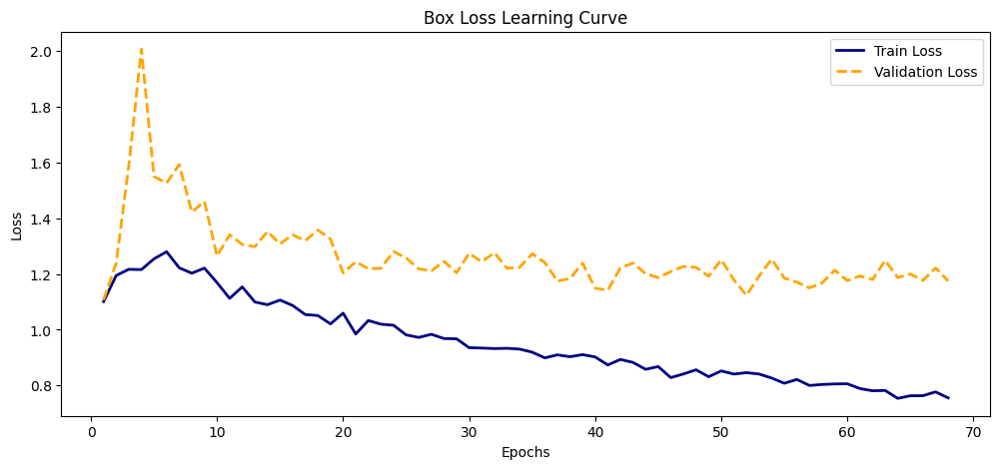

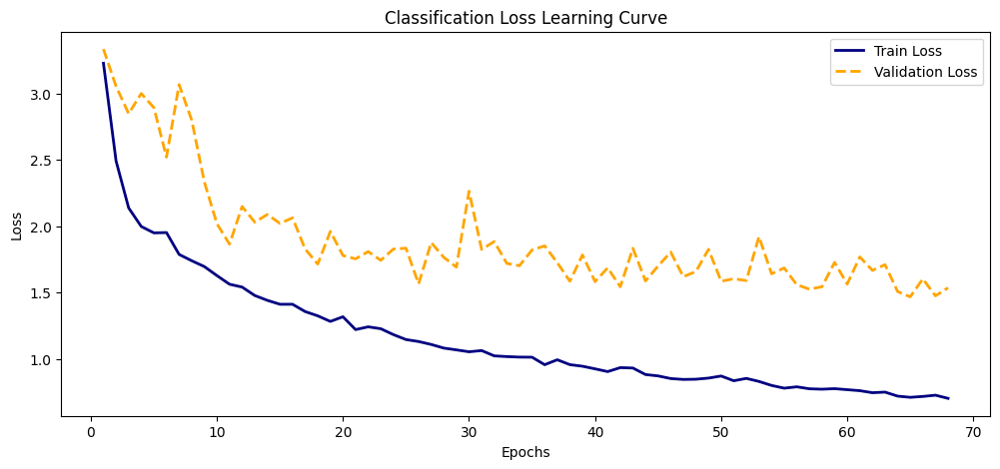

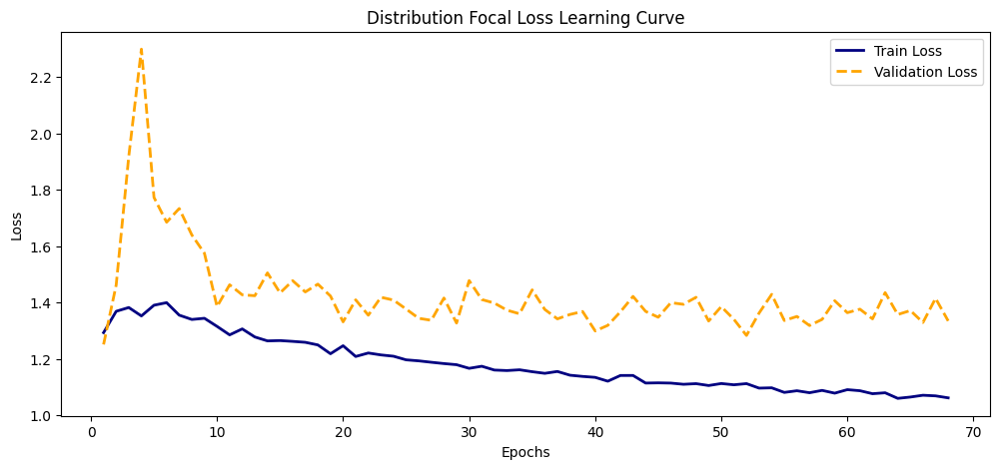

In [14]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv('/content/runs/detect/train/results.csv')

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

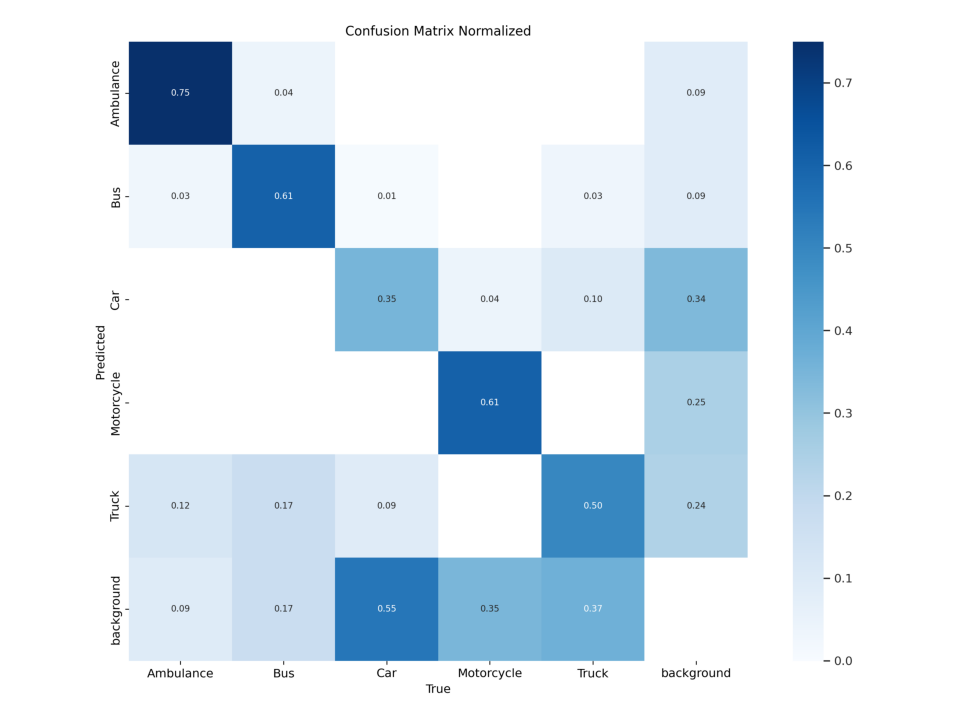

In [15]:
# Construct the path to the normalized confusion matrix image
# Assuming the confusion matrix is in the 'train2' folder instead of 'train'
confusion_matrix_path = '/content/runs/detect/train/confusion_matrix_normalized.png'

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Check if the image was loaded successfully
if cm_img is None:
    print(f"Error: Could not load image from {confusion_matrix_path}. Check if the file exists.")
else:
    # Convert the image from BGR to RGB color space for accurate color representation with matplotlib
    cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.figure(figsize=(10, 10), dpi=120)
    plt.imshow(cm_img)
    plt.axis('off')
    plt.show()

In [16]:
from ultralytics import YOLO
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = '/content/runs/detect/train/weights/best.pt'

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,583,127 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 1.2±1.7 ms, read: 9.3±8.7 MB/s, size: 31.0 KB)


val: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  5.15it/s]


                   all        250        454      0.594      0.588      0.592      0.444
             Ambulance         50         64      0.881      0.781      0.869      0.725
                   Bus         30         46      0.714      0.696      0.683      0.596
                   Car         90        238      0.609      0.345      0.424      0.278
            Motorcycle         42         46      0.462      0.652      0.557      0.306
                 Truck         38         60      0.304      0.467      0.426      0.315
Speed: 0.8ms preprocess, 3.4ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val


In [17]:
model = YOLO("yolo11s.pt")

In [18]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=150,              # Number of epochs to train for
    imgsz=416,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=10,             # Epochs to wait for no observable improvement for early stopping of training
    batch=8,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.3,             # Automatically restore best model# Use dropout regularization
    freeze=15,               # lets freeze the first 15 layers to use its original weight
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/CSE475/VehiclesDetectionDataset/dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.3, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=15, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0001, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0.0

train: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/train/labels.cache... 878 images, 0 backgrounds, 0 corrupt: 100%|██████████| 878/878 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 2.2±3.2 ms, read: 10.2±3.8 MB/s, size: 33.0 KB)


val: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      0.52G      1.051      1.809      1.252         28        416: 100%|██████████| 110/110 [00:15<00:00,  7.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  4.99it/s]


                   all        250        454      0.514      0.596        0.6      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150      0.67G      1.137      1.486        1.3         25        416: 100%|██████████| 110/110 [00:13<00:00,  7.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.15it/s]

                   all        250        454      0.605       0.64      0.633      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150     0.676G      1.137      1.347      1.277         24        416: 100%|██████████| 110/110 [00:13<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.91it/s]

                   all        250        454      0.666      0.558      0.605       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150     0.676G      1.147      1.372      1.287         17        416: 100%|██████████| 110/110 [00:15<00:00,  7.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.98it/s]

                   all        250        454      0.698      0.602      0.659      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/150     0.676G      1.129      1.338      1.255         16        416: 100%|██████████| 110/110 [00:13<00:00,  8.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.10it/s]

                   all        250        454      0.688      0.647       0.66      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150     0.676G      1.079      1.272      1.245         17        416: 100%|██████████| 110/110 [00:13<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.03it/s]

                   all        250        454      0.614      0.635      0.657        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150     0.693G      1.061       1.19      1.227         24        416: 100%|██████████| 110/110 [00:13<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  5.23it/s]

                   all        250        454       0.57      0.642       0.64      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150     0.717G      1.031      1.175      1.209         11        416: 100%|██████████| 110/110 [00:13<00:00,  8.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.31it/s]

                   all        250        454      0.718      0.623      0.675      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150     0.783G      1.031      1.136      1.209         21        416: 100%|██████████| 110/110 [00:13<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.21it/s]

                   all        250        454      0.658      0.647      0.645      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150     0.783G      1.025      1.098      1.206         20        416: 100%|██████████| 110/110 [00:13<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.86it/s]

                   all        250        454      0.674      0.583       0.64      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150     0.783G     0.9954      1.093      1.192         13        416: 100%|██████████| 110/110 [00:13<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.11it/s]

                   all        250        454      0.659       0.65      0.665      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150     0.783G      1.011      1.108      1.201         26        416: 100%|██████████| 110/110 [00:13<00:00,  8.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.81it/s]

                   all        250        454      0.738      0.615      0.682      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150     0.787G      1.005      1.064      1.189         36        416: 100%|██████████| 110/110 [00:13<00:00,  8.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.25it/s]

                   all        250        454      0.662      0.661      0.686      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150     0.814G     0.9582     0.9936      1.174         21        416: 100%|██████████| 110/110 [00:13<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.60it/s]

                   all        250        454      0.683      0.622      0.686       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      0.82G     0.9708      1.031       1.18         30        416: 100%|██████████| 110/110 [00:13<00:00,  8.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.78it/s]

                   all        250        454      0.636      0.656      0.684      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      0.82G      0.951      0.995      1.165         17        416: 100%|██████████| 110/110 [00:13<00:00,  7.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  7.48it/s]

                   all        250        454      0.679      0.687       0.69      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      0.82G     0.9297       0.96      1.152         29        416: 100%|██████████| 110/110 [00:13<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.25it/s]

                   all        250        454       0.58      0.739      0.678      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150     0.822G     0.9509     0.9917       1.17         29        416: 100%|██████████| 110/110 [00:13<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.03it/s]

                   all        250        454      0.644      0.646      0.673      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      0.84G     0.9179     0.9324      1.136         29        416: 100%|██████████| 110/110 [00:13<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.29it/s]

                   all        250        454      0.655       0.65      0.669      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150     0.863G      0.886     0.9329      1.133         20        416: 100%|██████████| 110/110 [00:13<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  6.09it/s]


                   all        250        454      0.567      0.722      0.677      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150     0.881G     0.8766     0.9001       1.13         27        416: 100%|██████████| 110/110 [00:13<00:00,  8.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:02<00:00,  5.49it/s]

                   all        250        454      0.594      0.723      0.682       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150     0.881G     0.9135     0.9325      1.133         12        416: 100%|██████████| 110/110 [00:13<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.18it/s]

                   all        250        454      0.731      0.601      0.695      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150     0.881G     0.8792     0.9053      1.121         29        416: 100%|██████████| 110/110 [00:13<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.40it/s]

                   all        250        454      0.654      0.651      0.682      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150     0.881G     0.8781     0.8894      1.131         21        416: 100%|██████████| 110/110 [00:13<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:01<00:00,  8.19it/s]

                   all        250        454      0.707      0.633      0.696       0.52
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 14, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



24 epochs completed in 0.109 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 19.1MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 19.1MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  5.15it/s]


                   all        250        454      0.683      0.621      0.685      0.532
             Ambulance         50         64      0.807      0.844       0.89      0.725
                   Bus         30         46      0.651      0.739      0.754      0.653
                   Car         90        238      0.718      0.437      0.574      0.393
            Motorcycle         42         46      0.709      0.783      0.747      0.543
                 Truck         38         60      0.533      0.305      0.461      0.345
Speed: 0.1ms preprocess, 3.0ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train2


In [19]:
# Define the path to the directory
post_training_files_path = '/content/runs/detect/train2'

# List the files in the directory
!ls {post_training_files_path}

args.yaml			 PR_curve.png	   val_batch0_labels.jpg
confusion_matrix_normalized.png  R_curve.png	   val_batch0_pred.jpg
confusion_matrix.png		 results.csv	   val_batch1_labels.jpg
F1_curve.png			 results.png	   val_batch1_pred.jpg
labels_correlogram.jpg		 train_batch0.jpg  val_batch2_labels.jpg
labels.jpg			 train_batch1.jpg  val_batch2_pred.jpg
P_curve.png			 train_batch2.jpg  weights


In [20]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='navy', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='green', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


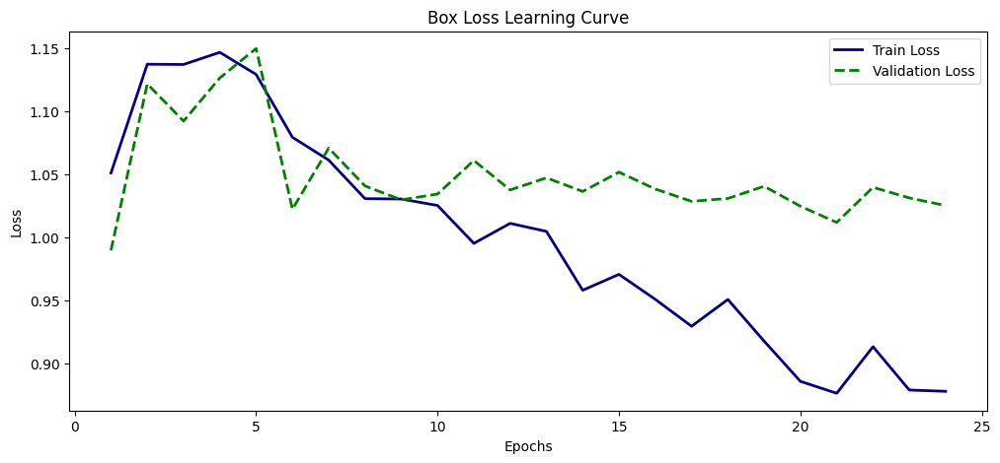

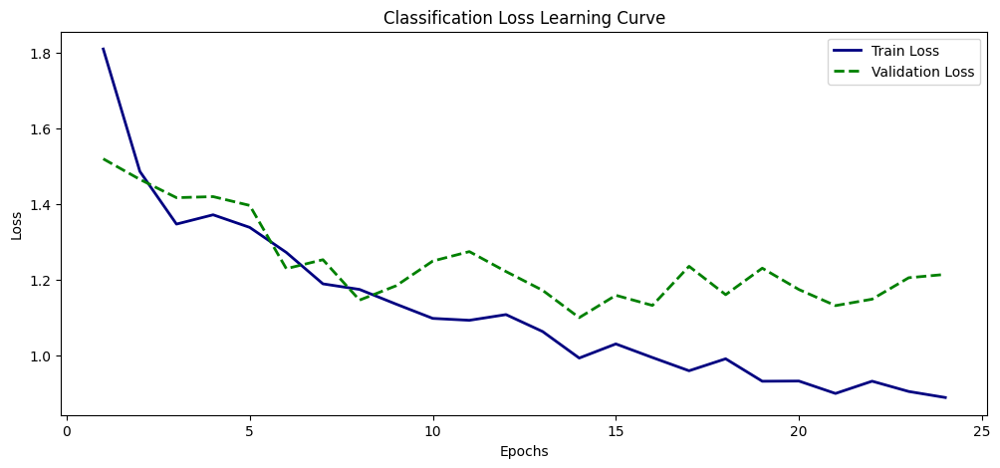

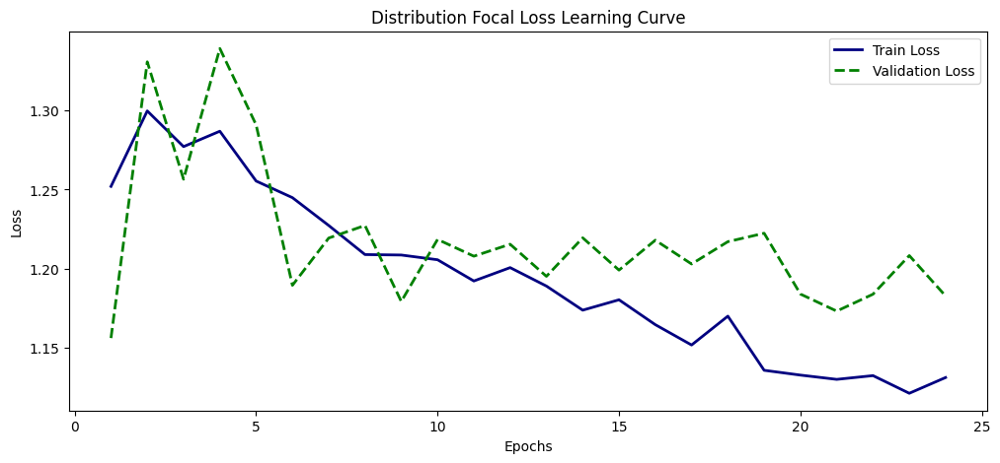

In [21]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, '/content/runs/detect/train2/results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

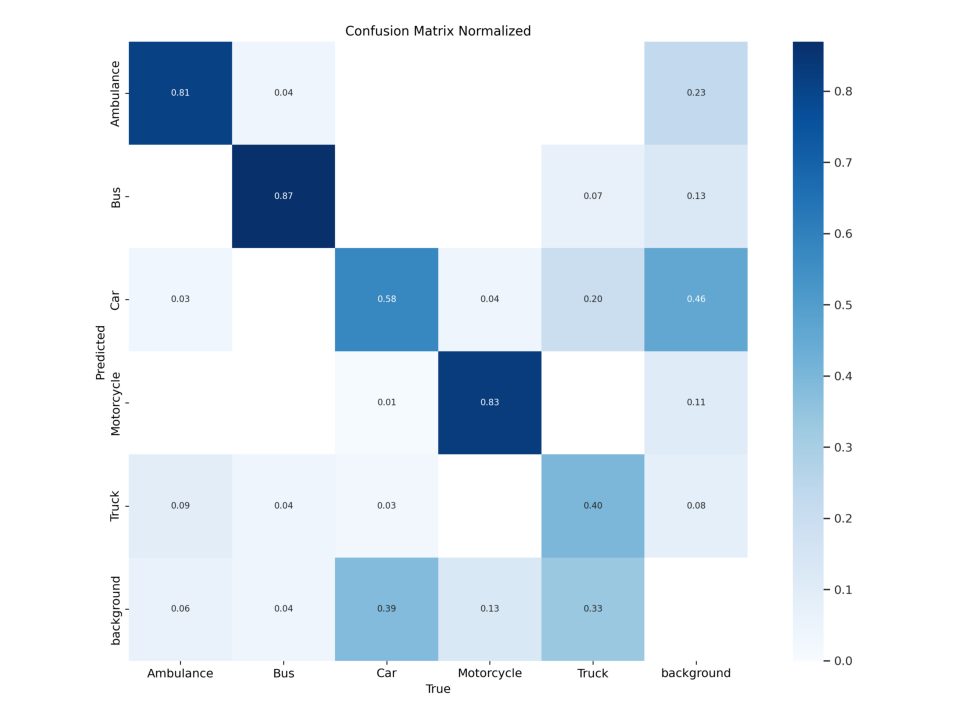

In [22]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, '/content/runs/detect/train2/confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off')
plt.show()


In [23]:
# Construct the path to the best model weights file using os.path.join
best_model_path_yolo_detect = os.path.join(post_training_files_path, '/content/runs/detect/train2/weights/best.pt')

# Load the best model weights into the YOLO model
best_model_yolo_detect = YOLO(best_model_path_yolo_detect)

# Validate the best model using the validation set with default parameters
metrics_yolo_detect = best_model_yolo_detect.val(split='val')

Ultralytics 8.3.128 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.4±0.1 ms, read: 19.1±4.9 MB/s, size: 31.0 KB)


val: Scanning /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/valid/labels.cache... 250 images, 0 backgrounds, 0 corrupt: 100%|██████████| 250/250 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  4.80it/s]


                   all        250        454      0.686      0.623      0.688      0.532
             Ambulance         50         64      0.807      0.844       0.89      0.725
                   Bus         30         46       0.65      0.739      0.755      0.654
                   Car         90        238      0.731      0.445      0.585      0.394
            Motorcycle         42         46      0.707      0.783      0.747      0.543
                 Truck         38         60      0.534      0.306      0.461      0.345
Speed: 0.5ms preprocess, 5.0ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/val2



image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.1f1f8cfcdfe052a8ec72e63b11889b66.jpg: 416x416 1 Truck, 10.4ms
Speed: 1.7ms preprocess, 10.4ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/test/images/aed83d879a22a6c4_jpg.rf.ada6c87c88d32689f79e3a03c9ebd314.jpg: 416x416 (no detections), 10.5ms
Speed: 1.6ms preprocess, 10.5ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/test/images/a3cffcdbff959432_jpg.rf.4MQ1NmvMx33nwLe9QSvu.jpg: 416x416 1 Truck, 11.5ms
Speed: 1.2ms preprocess, 11.5ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)

image 1/1 /content/drive/MyDrive/CSE475/VehiclesDetectionDataset/test/images/a7674f15d9b1f35f_jpg.rf.pL09u0Oz8DRvTB3AnBXT.jpg: 416x416 1 Ambulance, 10.6ms
Speed: 1.5ms preprocess, 10.6ms inference, 1.5ms postprocess per 

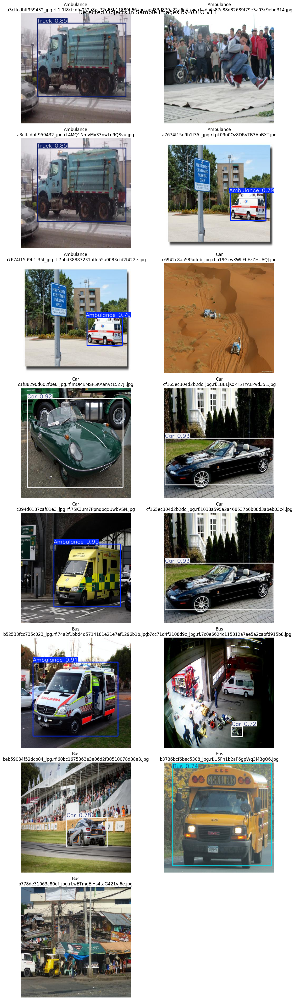

In [24]:
# Load the trained YOLO v11 segmentation model
best_model = YOLO("/content/runs/detect/train2/weights/best.pt")  # Update with your model path

# Path to the test image folder
test_images_path = Path("/content/drive/MyDrive/CSE475/VehiclesDetectionDataset/test/images")

# Define class mapping based on the first letter in filenames
class_mapping = {
    "A": "Ambulance",
    "C": "Car",
    "M": "Motorcycle",
    "B": "Bus",
    "T": "Truck"
}

# Collect images by class
image_classes = {cls: [] for cls in class_mapping.keys()}

# Ensure the directory exists
if not test_images_path.exists():
    raise FileNotFoundError(f"Error: The path {test_images_path} does not exist!")

# Iterate through images and categorize them
for img_name in os.listdir(test_images_path):
    if img_name.endswith(('.jpg', '.png', '.jpeg')):
        class_letter = img_name[0].upper()  # Convert to uppercase
        if class_letter in image_classes:
            image_classes[class_letter].append(img_name)

# Select 5 images per class
selected_images = []
for class_letter, img_list in image_classes.items():
    selected_images.extend([(class_letter, img) for img in img_list[:5]])

# ✅ Prevent crash if no images were found
if not selected_images:
    raise ValueError("No images were found matching the class mapping criteria. Check your filenames.")

# Set up figure with 2 vertical columns
num_images = len(selected_images)
num_rows = max(1, (num_images + 1) // 2)  # Ensure at least 1 row

fig, axes = plt.subplots(num_rows, 2, figsize=(12, 5 * num_rows))

# Flatten axes if more than one image
axes = axes.flatten() if num_images > 1 else [axes]

# Loop through selected images and display them
for idx, (class_letter, img_name) in enumerate(selected_images):
    img_path = test_images_path / img_name

    # Perform inference
    results = best_model.predict(source=str(img_path), imgsz=416, conf=0.7)
    annotated_img = results[0].plot(line_width=2)

    # Convert BGR to RGB
    annotated_img = cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB)

    # Display image
    axes[idx].imshow(annotated_img)
    axes[idx].set_title(f"{class_mapping[class_letter]}\n{img_name}", fontsize=12)
    axes[idx].axis("off")

# Remove extra subplots if images are not exactly even
for i in range(idx + 1, len(axes)):
    fig.delaxes(axes[i])

plt.suptitle("Detected Objects in Sample Images by YOLO v11", fontsize=16)
plt.tight_layout()
plt.show()


In [35]:
!pip install supervision --upgrade # Ensure that the `supervision` package is updated to the latest version.

import cv2
import os
import supervision as sv
from ultralytics import YOLO
from IPython.display import Video

# Load YOLO model
model = YOLO("/content/runs/detect/train/weights/best.pt")

# Annotators
bounding_box_annotator = sv.LineZoneAnnotator()
# Use sv.BoxAnnotator instead of sv.LabelAnnotator
label_annotator = sv.BoxAnnotator()

# Video paths
video_path = "/content/drive/MyDrive/CSE475/TestVideo/TrafficPolice.mp4"
output_path = "/content/drive/MyDrive/CSE475/output_TrafficPolice.mp4"
compressed_output_path = "/content/drive/MyDrive/CSE475/compressed_output_TrafficPolice.mp4"

# Open video
cap = cv2.VideoCapture(video_path)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Jump to frame 0 (start of video)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# Calculate the number of frames for 30 seconds
max_frames = int(fps * 30)  # Stop after 30 seconds

# Video writer
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

frame_count = 0

# Process only 30 seconds of video
while cap.isOpened() and frame_count < max_frames:
    ret, frame = cap.read()
    if not ret:
        break  # Exit if video ends

    results = model(frame, conf=0.5, verbose=False)[0]

    # Convert the Ultralytics results to Supervision Detections format
    detections = sv.Detections.from_yolov8(results) # Changed from from_ultralytics to from_yolov8

    # Annotate frame
    # The `annotate` method of `LineZoneAnnotator` in supervision v0.12.0
    # expects `image` and `zones` as arguments, not `scene` and `detections`.
    # Assuming you intend to draw bounding boxes based on the detections,
    # you should use the `BoxAnnotator` for this purpose.
    # annotated_frame = bounding_box_annotator.annotate(scene=frame, detections=detections)

    # Annotate the frame with bounding boxes using BoxAnnotator
    annotated_frame = label_annotator.annotate(scene=frame, detections=detections)

    out.write(annotated_frame)
    frame_count += 1  # Keep track of processed frames

cap.release()
out.release()

# 🔹 Compress only the 10-second clip using FFmpeg
os.system(f"ffmpeg -y -t 30 -i {output_path} -vcodec libx264 -crf 30 {compressed_output_path}")

# 🔹 Display the compressed video preview
Video(compressed_output_path, embed=True)

In [27]:
!pip install supervision --upgrade

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 181.5/181.5 kB 11.7 MB/s eta 0:00:00
  Attempting uninstall: supervision
    Found existing installation: supervision 0.8.0
    Uninstalling supervision-0.8.0:
      Successfully uninstalled supervision-0.8.0
